# SPH0645LM4H-B i2s microphone sensitivity measurements on ROBAT 226.238:

This report is used to calibrate the sensitivity of the SPH0645 I2S microphone array using a GRAS reference microphone. 
The calibration is done by playing back a series of chirp sweeps and measuring the response of both microphones. 
The sensitivity is calculated in terms of dB SPL (Sound Pressure Level) relative to 20 μPa.

Data for the experiments have been collected on May 9th, 2025, along with the measurements used to calculate the array directivity.

ROBAT 226.238:
- 5 mic array adafruit 5 i2s SPH0645LM4H-B from Knowles (https://cdn-shop.adafruit.com/product-files/3421/i2S+Datasheet.PDF),
    mounted on a custom PCB from Adafruit (https://www.adafruit.com/product/3421#description)
- 48khz recording from the array mics
- 192 KHz recordings from the GRAS reference mic (GRAS 40BF + 26AC preamplifier)
- 1.5 meters distance (~ far field = 10𝛌; 𝛌max = fmin; 343/2 = 171 Hz --> 10𝛌 = 1715 Hz; at 1000Hz: 4.5𝛌 = 4.5*0.343 = 1.5435 m)

**HW settings:**
- Harman kandon AWR 445 vol = -40 db 
- fireface analog out 1/2 stereo vol = 0 db
- tweeter #1
- Ref mic: gras +30 db fireface channel 9, +20db channel A power module

**WARNING**
This code is mostly derived from the code: 
    
    example_w-deconvolution_runthrough.py

at this link: https://github.com/activesensingcollectives/calibrate-mic/blob/master/example_w-deconvolution_runthrough.py
and makes use of:

    utilities.py
    
both developed by Thejasvi Beleyur. 

Created on June 5 2025

@author: Alberto Doimo

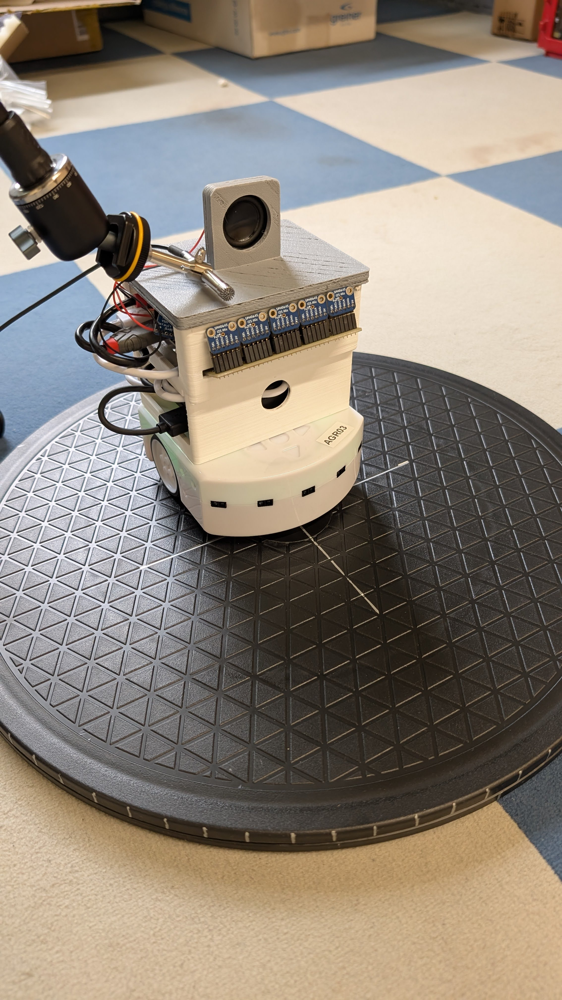

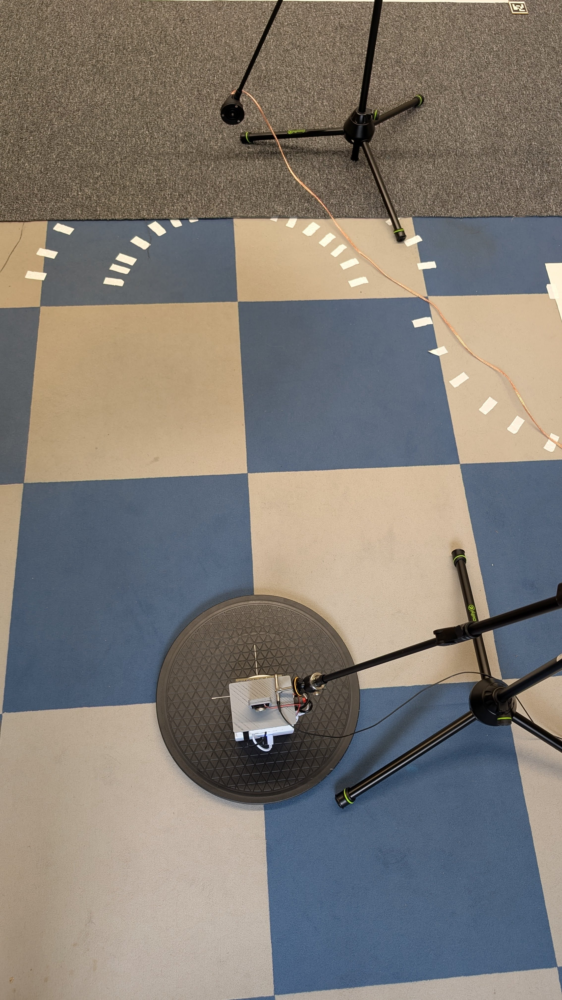

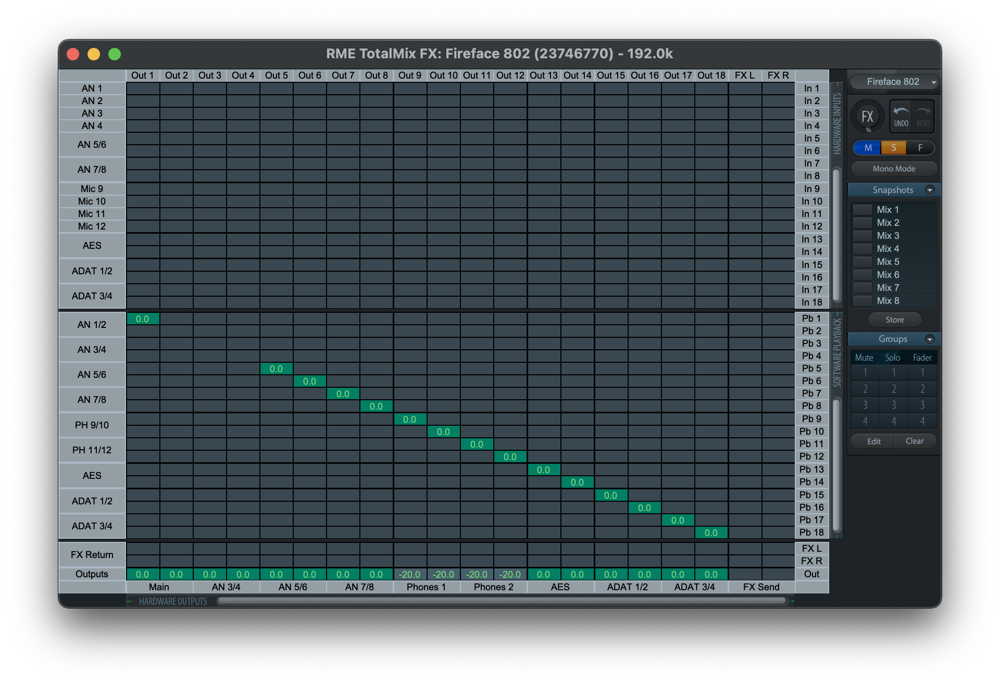

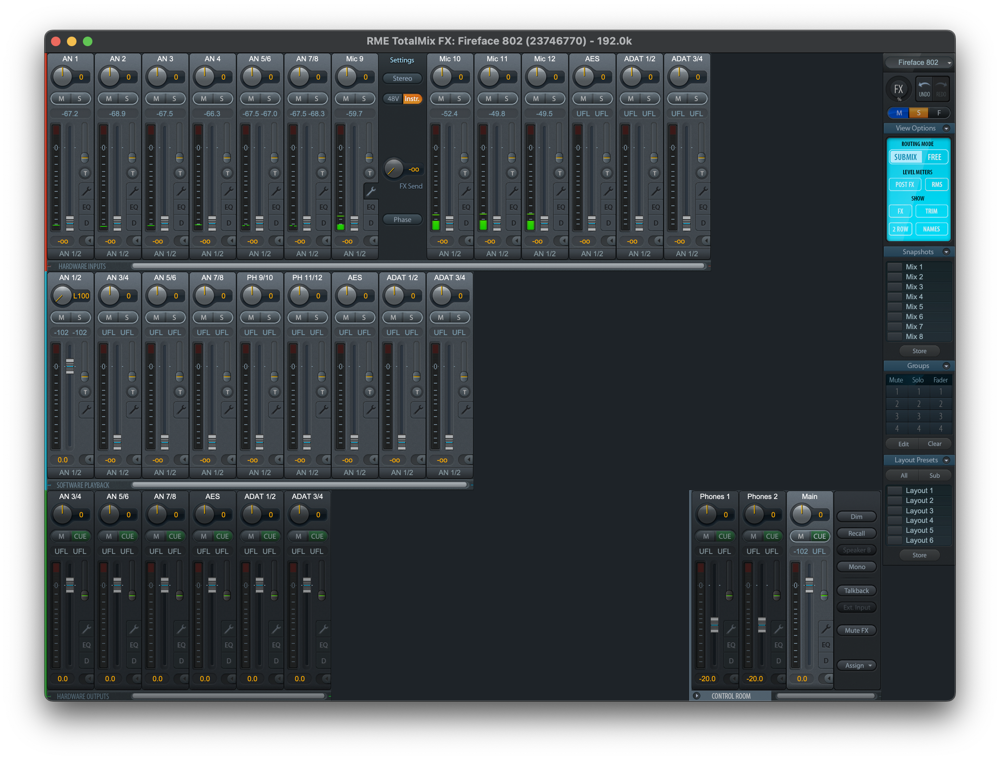

In [1]:
from IPython.display import Image
from IPython.display import display

display(
    Image(filename="./PXL_20250509_10061094.jpg", width=400),
    Image(filename="./PXL_20250509_10062195.jpg", width=400),
    Image(filename="./rme802_matrix.png", width=800),
    Image(filename="./rme802_mixer.png", width=800)
)

# Output signal

Out signal used during the recordings: 0.2-24Khz multiple sweeps at 192 khz from the amplifier.
Having a signal with different set of sweeps of different length, allows to have repeatibility of the same signal type (useful to avarage and reduce errors), but also having the sweep energy distributed over different time frames. 

**IMPORTANT NOTE**

The signal was reproduced from windows 11 and using Windows Media Player Software which result in outputting only the first 4 out of 5 sweeps, correctly spaced in time. Possibly there is an unexpected resampling or a digital cut of the last portion of the file, but it shouldn't affect the results, since this report only uses the first sweeps for the analysis.

/home/alberto/miniconda3/envs/robat2/lib/python3.11/site-packages/matplotlib/axes/_axes.py:7947: RuntimeWarning: divide by zero encountered in log10
  Z = 10. * np.log10(spec)


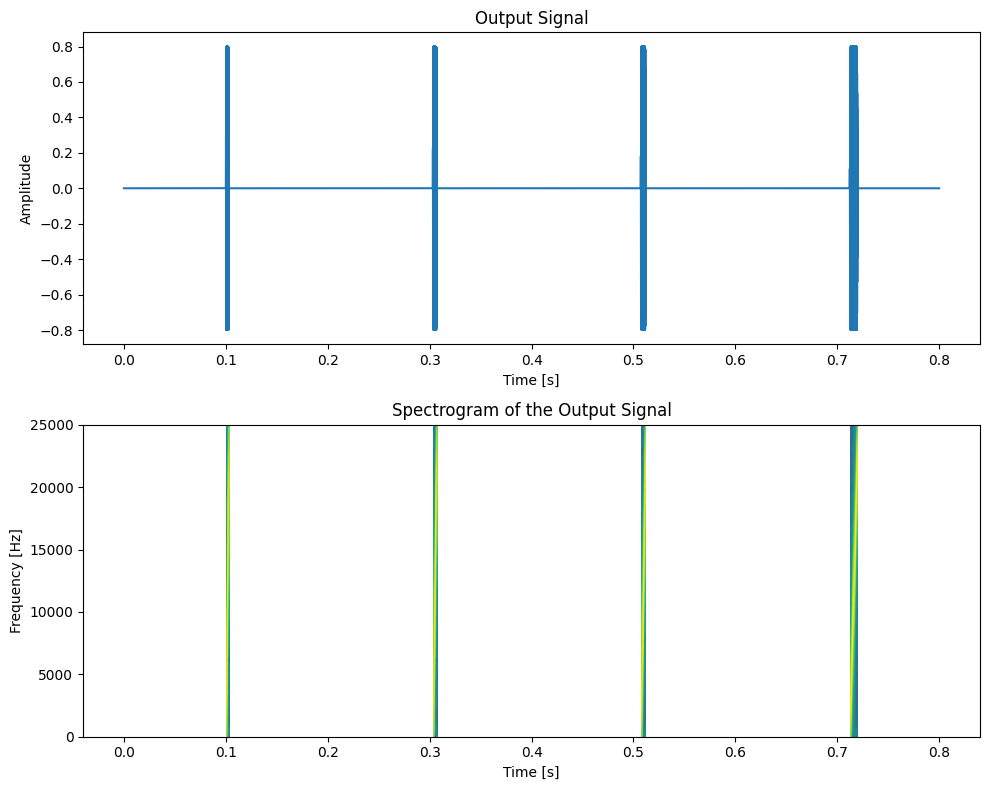

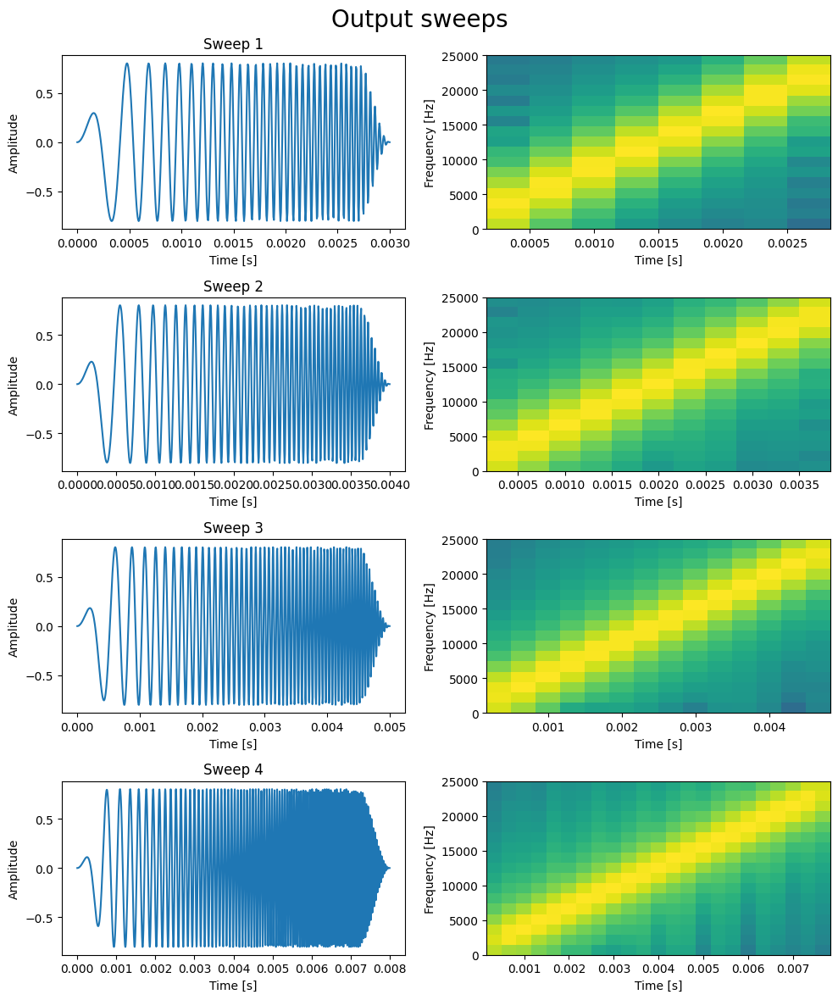

In [2]:
import numpy as np 
import soundfile as sf
import matplotlib.pyplot as plt 
from utilities import *
import scipy.signal as sig

durns = np.array([3, 4, 5, 8] )*1e-3 # chirps durations in seconds
fs = 192000 # sampling frequency

chirp = []
all_sweeps = []
for durn in durns:
    t = np.linspace(0, durn, int(fs*durn))
    start_f, end_f = 2e2, 24e3
    sweep = signal.chirp(t, start_f, t[-1], end_f)
    sweep *= signal.windows.tukey(sweep.size, 0.2)
    sweep *= 0.8
    sweep_padded = np.pad(sweep, pad_width=[int(fs*0.1)]*2, constant_values=[0,0])
    all_sweeps.append(sweep_padded)
    chirp.append(sweep)

# Read the saved WAV file
out_signal, _ = sf.read('./2025-06-03/02_24k_5sweeps.wav')
out_signal = out_signal[0:int(0.8*fs)]  # Take only the first 0.8 seconds (see note above)

# Plot the time-domain signal and spectrogram
plt.figure(figsize=(10, 8))

# Time-domain plot
plt.subplot(2, 1, 1)
plt.plot(np.linspace(0, len(out_signal) / fs, len(out_signal)), out_signal)
plt.title('Output Signal')
plt.xlabel('Time [s]')
plt.ylabel('Amplitude')

# Spectrogram plot
plt.subplot(2, 1, 2, sharex=plt.gca())
plt.specgram(out_signal, Fs=fs, NFFT=512, noverlap=256, cmap='viridis')
plt.title('Spectrogram of the Output Signal')
plt.xlabel('Time [s]')
plt.ylabel('Frequency [Hz]')
plt.ylim(0, 25e3)
plt.tight_layout()

plt.figure(figsize=(10, 12))
for i, sweep in enumerate(chirp):
    plt.subplot(len(chirp), 2, 2 * i + 1)
    plt.plot(np.linspace(0, len(sweep) / fs, len(sweep)), sweep)
    plt.title(f'Sweep {i+1}')
    plt.xlabel('Time [s]')
    plt.ylabel('Amplitude')
    # Spectrogram plot

    plt.subplot(len(chirp), 2, 2 * i + 2)
    plt.specgram(sweep, Fs=fs, NFFT=128, noverlap=64, cmap='viridis')
    plt.xlabel('Time [s]')
    plt.ylabel('Frequency [Hz]')
    plt.ylim(0, 25e3)
    plt.suptitle('Output sweeps', fontsize=20)

plt.tight_layout()
plt.show()

# Audio analysis of the recordings

A preprocessing of the signal is needed, since the array has 5 mics:
1. The angular audiofiles are imported and extracted from multiwav to single channel recordings.


In [3]:
# Extract the single channels
import os

DIR = "./2025-06-03/original_40/"  # Directory containing the audio files

audio_files = os.listdir(DIR)  # List all files in the sweeps directory
audio_files.sort()  # Sort the files in ascending order

# Directory to save the extracted channels
output_dir = "./2025-06-03/extracted_channels/"
os.makedirs(output_dir, exist_ok=True)  # Create the directory if it doesn't exist

# Path to the multi-channel WAV file
for file in audio_files:
    file_path = os.path.join(DIR, file)

    angle_name = file.split('.')[0]
    print(f"Processing file: {angle_name}")

    # Read the multi-channel WAV file
    audio_data, sample_rate = sf.read(DIR + file)
    
    # Check the shape of the audio data
    print(f"Audio data shape: {audio_data.shape}")  # (samples, channels)

    # Extract individual channels
    num_channels = audio_data.shape[1]  # Number of channels
    channels = [audio_data[:, i] for i in range(num_channels)]

    # Save each channel as a separate WAV file
    for i, channel_data in enumerate(channels):
        output_file = os.path.join(output_dir + "channel_separation", angle_name+f"_{i + 1}.wav")  # Path to the output file
        os.makedirs(output_dir + "channel_separation", exist_ok=True)  # Create the directory if it doesn't exist
        sf.write(output_file, channel_data, sample_rate)
        print(f"Saved channel {i + 1} to {output_file}")

Processing file: 000
Audio data shape: (503773, 5)
Saved channel 1 to ./2025-06-03/extracted_channels/channel_separation/000_1.wav
Saved channel 2 to ./2025-06-03/extracted_channels/channel_separation/000_2.wav
Saved channel 3 to ./2025-06-03/extracted_channels/channel_separation/000_3.wav
Saved channel 4 to ./2025-06-03/extracted_channels/channel_separation/000_4.wav
Saved channel 5 to ./2025-06-03/extracted_channels/channel_separation/000_5.wav


2. HighPass filtering, matched filtering, peak extraction:
 - The file is uploaded and HP filtered to eliminate the DC bias of the mics. 
 - The file is matched with the output chirp template.
 - The sweep position is extracted.

**NOTE**

This analysis uses only the microphone 3 of the array (the central one)


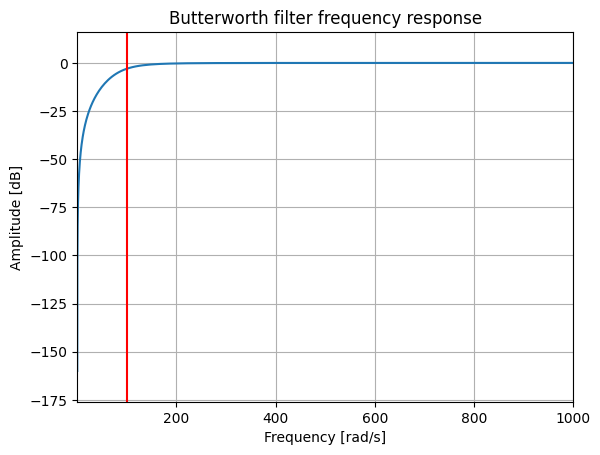

Detected peaks: gras = 8, SPH0645 = 8


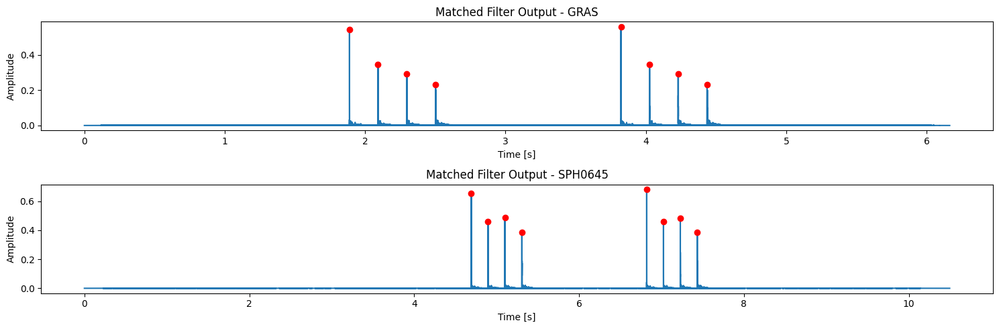

In [4]:
# Define the matched filter function
def matched_filter(recording, chirp_template):
    filtered_output = np.roll(signal.correlate(recording, chirp_template, 'same', method='direct'), -len(chirp_template)//2)
    filtered_output *= signal.windows.tukey(filtered_output.size, 0.1)
    filtered_envelope = np.abs(signal.hilbert(filtered_output))
    return filtered_envelope

# Detect peaks in the matched filter output
def detect_peaks(filtered_output, sample_rate):
    peaks, properties = signal.find_peaks(filtered_output, prominence=0.2, distance=0.2 * sample_rate)
    return peaks

# Design the highpass filter
cutoff = 100 # cutoff frequency in Hz
# Plot the filter frequency response
b, a = signal.butter(2, cutoff, 'high', analog=True)
w, h = signal.freqs(b, a)
plt.plot(w, 20 * np.log10(abs(h)))
plt.title('Butterworth filter frequency response')
plt.xlabel('Frequency [rad/s]')
plt.ylabel('Amplitude [dB]')
plt.margins(0, 0.1)
plt.grid(which='both', axis='both')
plt.axvline(cutoff, color='red') # cutoff frequency
plt.show()

# load the GRAS and SPH0645 audio files
gras_pbk_audio_or, fs_gras = sf.read('./2025-06-03/-40db_02-250603_1759-01.wav')
SPH0645_pbk_audio_or, fs_SPH0645 = sf.read('./2025-06-03/extracted_channels/channel_separation/000_3.wav')

chirp_to_use = 0

# resampling 
gras_pbk_audio_res = sig.resample(gras_pbk_audio_or, int(fs_SPH0645*len(gras_pbk_audio_or)/fs_gras))
chirp[chirp_to_use] = sig.resample(chirp[chirp_to_use], int(fs_SPH0645*len(chirp[chirp_to_use])/fs))

# Apply the filter
sos = signal.butter(2, cutoff, 'hp', fs=fs_SPH0645, output='sos')
gras_pbk_audio_filt = sig.sosfilt(sos, gras_pbk_audio_res)
SPH0645_pbk_audio_filt = sig.sosfilt(sos, SPH0645_pbk_audio_or)

gras_pbk_audio_matched = matched_filter(gras_pbk_audio_filt, chirp[chirp_to_use])
SPH0645_pbk_audio_matched = matched_filter(SPH0645_pbk_audio_filt, chirp[chirp_to_use])

# Detect peaks
peaks_gras = detect_peaks(gras_pbk_audio_matched, fs_SPH0645)
peaks_SPH0645 = detect_peaks(SPH0645_pbk_audio_matched, fs_SPH0645)
print(f"Detected peaks: gras = {len(peaks_gras)}, SPH0645 = {len(peaks_SPH0645)}")

# plot the peaks
plt.figure(figsize=(15, 5))
plt.subplot(2, 1, 1)
plt.plot(np.linspace(0, len(gras_pbk_audio_matched) / fs_SPH0645, len(gras_pbk_audio_matched)), gras_pbk_audio_matched)
plt.plot(peaks_gras/fs_SPH0645, gras_pbk_audio_matched[peaks_gras], 'ro')
plt.title('Matched Filter Output - GRAS')
plt.xlabel('Time [s]')
plt.ylabel('Amplitude')
#plt.xlim(3.5, 3.54)
plt.subplot(2, 1, 2)
plt.plot(np.linspace(0, len(SPH0645_pbk_audio_matched) / fs_SPH0645, len(SPH0645_pbk_audio_matched)), SPH0645_pbk_audio_matched)
plt.plot(peaks_SPH0645/fs_SPH0645, SPH0645_pbk_audio_matched[peaks_SPH0645], 'ro')
plt.title('Matched Filter Output - SPH0645')
plt.xlabel('Time [s]')
plt.ylabel('Amplitude')
#plt.xlim(4.325, 4.34)
plt.tight_layout()
plt.show()

3. The filtered sweeps in the files can be visualised to check for consistency. 

    **NOTE**

    A resampling is needed since the audiofiles from the GRAS are at 192 KHz, while those from the SPH0645LM4H-B at 48 KHz.

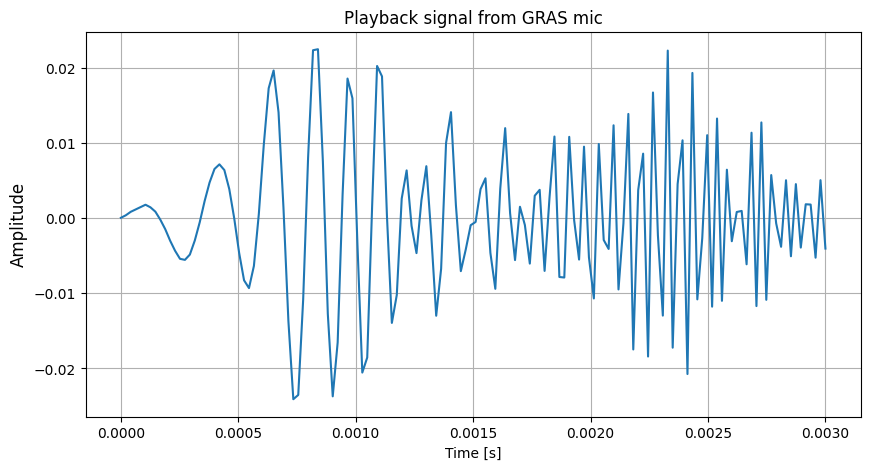

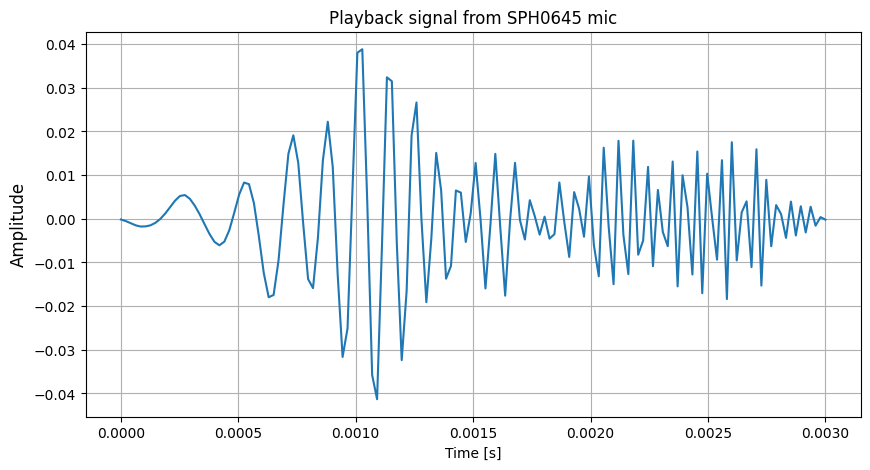

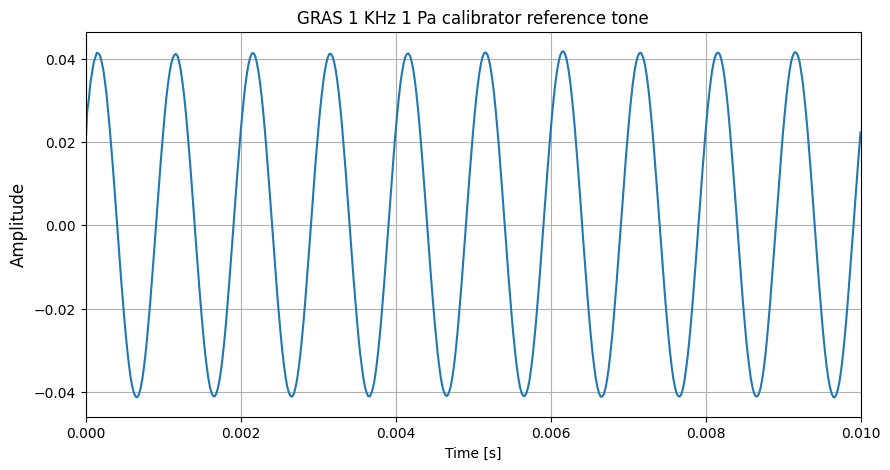

In [5]:
gras_pbk_audio = gras_pbk_audio_filt[int(peaks_gras[chirp_to_use]):int(peaks_gras[chirp_to_use]) + int(fs_SPH0645*durns[chirp_to_use])]
SPH0645_pbk_audio = SPH0645_pbk_audio_filt[int(peaks_SPH0645[chirp_to_use]):int(peaks_SPH0645[chirp_to_use]) + int(fs_SPH0645*durns[chirp_to_use])]

# Plot the playback signals
plt.figure(figsize=(10,5))
plt.plot(np.linspace(0,len(gras_pbk_audio)/fs_SPH0645, len(gras_pbk_audio)) ,gras_pbk_audio)
plt.title('Playback signal from GRAS mic')
plt.grid()
plt.xlabel('Time [s]')
plt.ylabel('Amplitude', fontsize=12)
plt.figure(figsize=(10,5))
plt.plot(np.linspace(0,len(SPH0645_pbk_audio)/fs_SPH0645, len(SPH0645_pbk_audio)), SPH0645_pbk_audio)
plt.title('Playback signal from SPH0645 mic')
plt.grid()
plt.xlabel('Time [s]')
plt.ylabel('Amplitude', fontsize=12)

# Load the 1 Pa reference tone 
gras_1Pa_tone, fs_gras = sf.read('./2025-06-03/ref_tone_gras_1Pa_ch9_30dB_chA_20dB.wav', start=int(fs_gras*0.5),
                        stop=int(fs_gras*1.5))

gras_1Pa_tone = sig.resample(gras_1Pa_tone, fs_SPH0645*1)

# Plot the reference tone
plt.figure(figsize=(10,5))
plt.plot(np.linspace(0,len(gras_1Pa_tone)/fs_SPH0645, len(gras_1Pa_tone)), gras_1Pa_tone)
plt.title('GRAS 1 KHz 1 Pa calibrator reference tone')
plt.xlim(0, 0.01)
plt.xlabel('Time [s]')
plt.ylabel('Amplitude', fontsize=12)
plt.grid()

4. SNR analysis:
- Noise chunks from the recorded file is trimmed to calculate SNR.
- SNRs from all the frequency bands are saved and plotted.


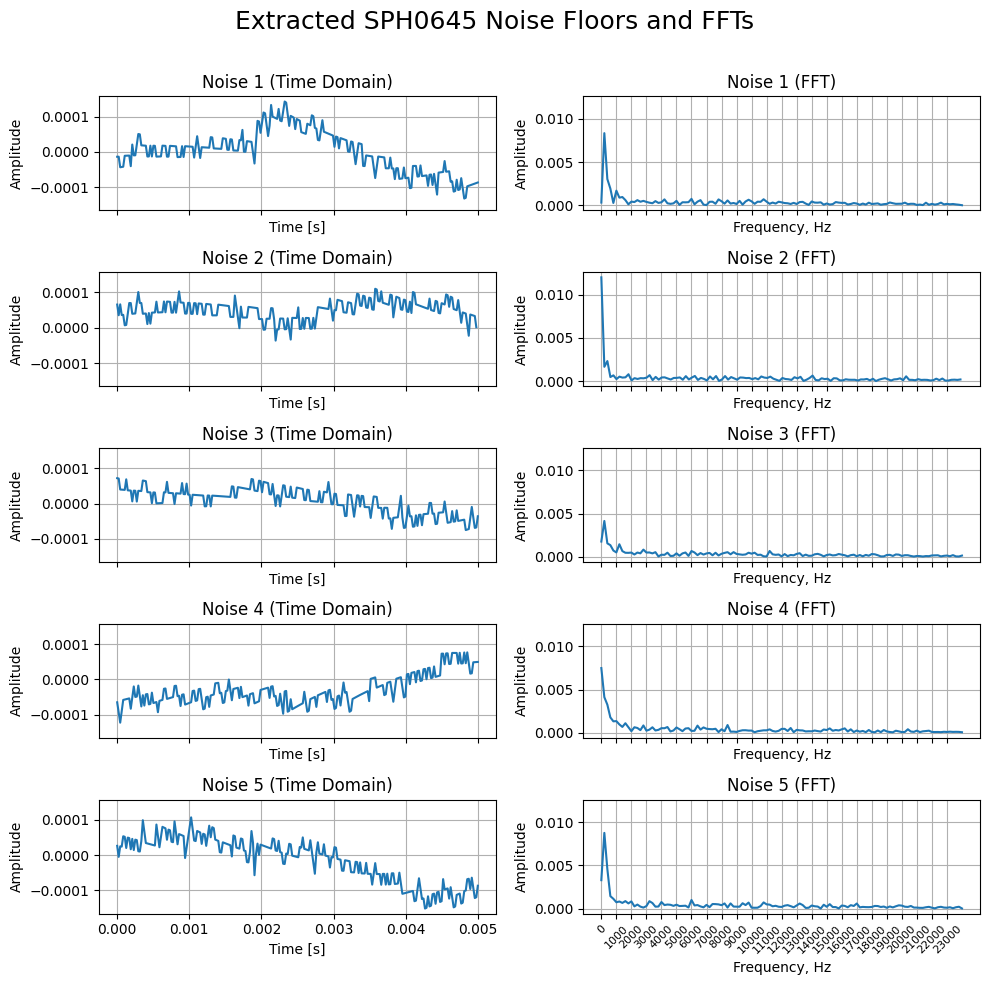

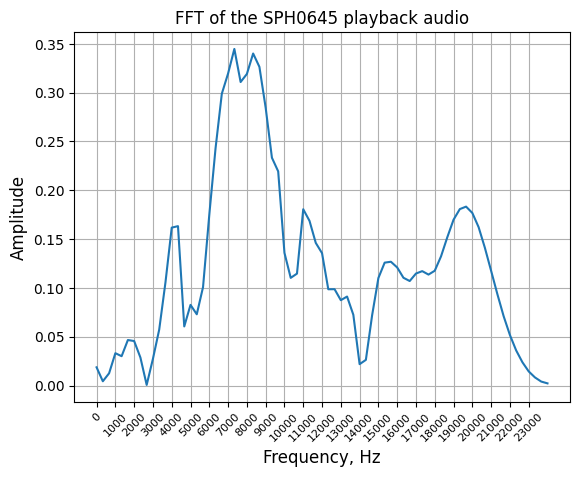

/home/alberto/miniconda3/envs/robat2/lib/python3.11/site-packages/matplotlib/cbook.py:1699: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
/home/alberto/miniconda3/envs/robat2/lib/python3.11/site-packages/matplotlib/cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


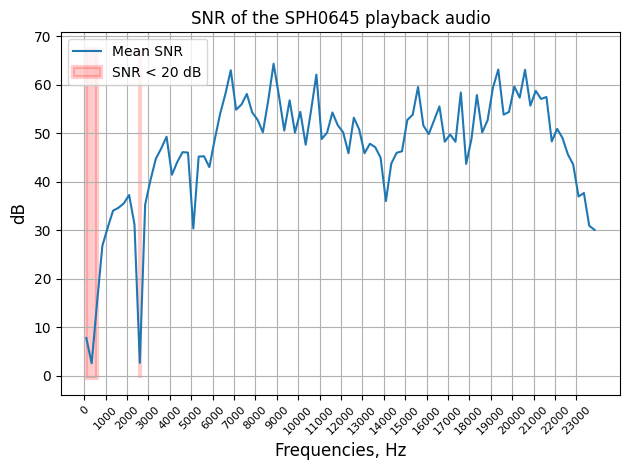

In [6]:
# SNR computation between the sweeps and the noise floor measurements for each freq band 

central_freq = np.arange(100, fs_SPH0645//2, 250) 
BW = 0.25e3 # Bandwidth of the bands

def calculate_snr(audio, noise):

    # Compute signal power (RMS value squared)
    P_signal = np.mean(audio**2)

    # extract noise power
    P_noise = np.mean(noise**2)

    # Compute SNR in dB
    SNR = P_signal / P_noise

    SNR_dB = 10 * np.log10(SNR)  # Convert to dB scale

    return SNR, SNR_dB

# Use the initial part opf the GRAS recording as noise
noise_SPH0645_1 = SPH0645_pbk_audio_filt[int(0.5*fs_SPH0645):int(0.505*fs_SPH0645)] 
noise_SPH0645_2 = SPH0645_pbk_audio_filt[int(1*fs_SPH0645):int(1.005*fs_SPH0645)]
noise_SPH0645_3 = SPH0645_pbk_audio_filt[int(1.5*fs_SPH0645):int(1.505*fs_SPH0645)]
noise_SPH0645_4 = SPH0645_pbk_audio_filt[int(2*fs_SPH0645):int(2.005*fs_SPH0645)]
noise_SPH0645_5 = SPH0645_pbk_audio_filt[int(3*fs_SPH0645):int(3.005*fs_SPH0645)]
noises = [noise_SPH0645_1, noise_SPH0645_2, noise_SPH0645_3, noise_SPH0645_4, noise_SPH0645_5]

# Plot the noise files and their FFTs in a 6x2 grid
fig, axs = plt.subplots(5, 2, figsize=(10, 10), sharey='col', sharex='col')
titles = ['Noise 1', 'Noise 2', 'Noise 3', 'Noise 4', 'Noise 5']

Noise_ffts = []
for i, (noise, title) in enumerate(zip(noises, titles)):
    # Time domain plot
    ax_time = axs[i, 0]
    ax_time.plot(np.linspace(0, len(noise)/fs_SPH0645, len(noise)), noise)
    ax_time.set_title(f'{title} (Time Domain)')
    ax_time.set_xlabel('Time [s]')
    ax_time.set_ylabel('Amplitude')
    ax_time.grid()

    # Frequency domain plot
    Noise_fft = np.fft.rfft(noise)
    Noise_fftfreqs = np.fft.rfftfreq(noise.size, 1/fs_SPH0645)
    Noise_ffts.append(Noise_fft)

    ax_freq = axs[i, 1]
    ax_freq.plot(Noise_fftfreqs, np.abs(Noise_fft))
    ax_freq.set_title(f'{title} (FFT)')
    ax_freq.set_xlabel('Frequency, Hz')
    ax_freq.set_ylabel('Amplitude')
    ax_freq.set_xticks(np.arange(0, fs_SPH0645//2, 1000))
    ax_freq.tick_params(axis='x', rotation=45, labelsize=8)
    ax_freq.grid()


plt.suptitle('Extracted SPH0645 Noise Floors and FFTs', fontsize=18)
plt.tight_layout(rect=[0, 0, 1, 0.97])
plt.show()

# Signal fft of SPH0645 playback audio
SPH0645_fft = np.fft.rfft(SPH0645_pbk_audio) # Compute the FFT of the noise files
SPH0645_fftfreqs = np.fft.rfftfreq(SPH0645_pbk_audio.size, 1/fs_SPH0645)

plt.figure()
plt.plot(SPH0645_fftfreqs,np.abs(SPH0645_fft))
plt.xlabel('Frequency, Hz', fontsize=12)
plt.ylabel('Amplitude', fontsize=12)
plt.title('FFT of the SPH0645 playback audio')
plt.xticks(np.arange(0, fs_SPH0645//2, 1000), rotation=45, fontsize=8)
plt.grid()
plt.show()

all_snrs = {}
for i in range(len(noises)):
    Noise_fft = Noise_ffts[i]
    Noise_fftfreqs = np.fft.rfftfreq(noises[i].size, 1/fs_SPH0645)
    snrs = []
    for fc in central_freq:
        snr_value, snr_value_db = calculate_snr(
                                SPH0645_fft[(SPH0645_fftfreqs < fc + BW) & (SPH0645_fftfreqs > fc - BW)],    
                                Noise_fft[(Noise_fftfreqs < fc + BW) & (Noise_fftfreqs > fc - BW)]) # Compute the SNR in the band
        snrs.append(snr_value)
    snrs = np.array(snrs)
    # Store SNRs for each noise segment in a list or array indexed by i
    all_snrs[i] = snrs
SNR = np.mean(list(all_snrs.values()), axis=0) # Average the SNRs across all noise segments

# Plot the SNR
plt.figure()
plt.plot(central_freq, 10 * np.log10(SNR), label='Mean SNR')
# Mark with red zone the frequencies with SNR lower than 20 dB
snr_db = 10 * np.log10(SNR)
low_snr_mask = snr_db < 20
if np.any(low_snr_mask):
    plt.fill_between(central_freq, plt.ylim()[0], plt.ylim()[1], where=low_snr_mask, color='red', alpha=0.2, label='SNR < 20 dB', linewidth=3)

plt.xlabel('Frequencies, Hz', fontsize=12);
plt.ylabel('dB', fontsize=12)
plt.grid()
plt.xticks(np.arange(0, fs_SPH0645//2, 1000), rotation=45, fontsize=8)
plt.title('SNR of the SPH0645 playback audio')
plt.legend()
plt.tight_layout()
plt.show()


5. The GRAS calibration mic frequency response is calculated and plotted, considering the 1 Pa 1Khz reference tone provided by the *Brüel & Kjær Type 4231* calibrator 

The calibration mic has a sensitivity of 0.029rms/Pa. RMS relevant only for this ADC!

Infos about the frequencies considered in the analysis:
Index for starting freq = 200.0 Hz: 1, correspondent frequency band: 333.3333333333333 Hz
Index for ending freq = 24000.0 Hz: 72, correspondent frequency band: 24000.0 Hz


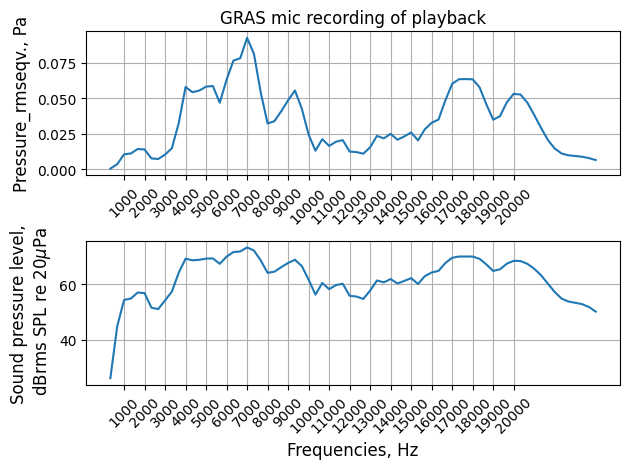

In [7]:
# Calibration mic: Calculate the rms_Pascal of the 1 Pa calibration tone
rms_1Pa_tone = rms(gras_1Pa_tone)
print(f'The calibration mic has a sensitivity of {np.round(rms_1Pa_tone,3)}rms/Pa. RMS relevant only for this ADC!')

# Now measure mic RMS over all frequency bands
gras_centrefreqs, gras_freqrms = calc_native_freqwise_rms(gras_pbk_audio, fs_SPH0645)

# Filter out the frequencies that are not in the original signal 
mask = (gras_centrefreqs >= start_f) & (gras_centrefreqs <= end_f)

idx_start = np.where(gras_centrefreqs >= start_f)[0][0]
idx_end = np.where(gras_centrefreqs <= end_f)[0][-1]
print("\nInfos about the frequencies considered in the analysis:")
print(f"Index for starting freq = {start_f} Hz: {idx_start}, correspondent frequency band: {gras_centrefreqs[idx_start]} Hz")
print(f"Index for ending freq = {end_f} Hz: {idx_end}, correspondent frequency band: {gras_centrefreqs[idx_end]} Hz")

gras_centrefreqs = gras_centrefreqs[mask]

gras_freqrms = gras_freqrms[idx_start:idx_end+1]

# Convert from RMS to Pascals (rms equivalent) since we know the GRAS sensitivity
gras_freqParms = gras_freqrms/rms_1Pa_tone # now the levels of each freq band in Pa_rms

# plot 
plt.figure()
a0 = plt.subplot(211)
plt.plot(gras_centrefreqs, gras_freqParms)
plt.ylabel('Pressure_rmseqv., Pa', fontsize=12)
plt.title('GRAS mic recording of playback')
plt.grid()
plt.xticks(np.linspace(1000, 20000, 20), rotation=45)
plt.subplot(212, sharex=a0)
plt.plot(gras_centrefreqs, pascal_to_dbspl(gras_freqParms))
plt.xlabel('Frequencies, Hz', fontsize=12);
plt.ylabel('Sound pressure level,\n dBrms SPL re 20$\mu$Pa', fontsize=12)
plt.grid()
plt.xticks(np.linspace(1000, 20000, 20), rotation=45)
plt.tight_layout()


6. Target microphone analysis: the mic frequency response is calculated and plotted. The results only refer to rms avarage units (a.u.).

Infos about the frequencies considered in the analysis:
Index for starting freq = 200.0 Hz: 1, correspondent frequency band: 333.3333333333333 Hz
Index for ending freq = 24000.0 Hz: 72, correspondent frequency band: 24000.0 Hz


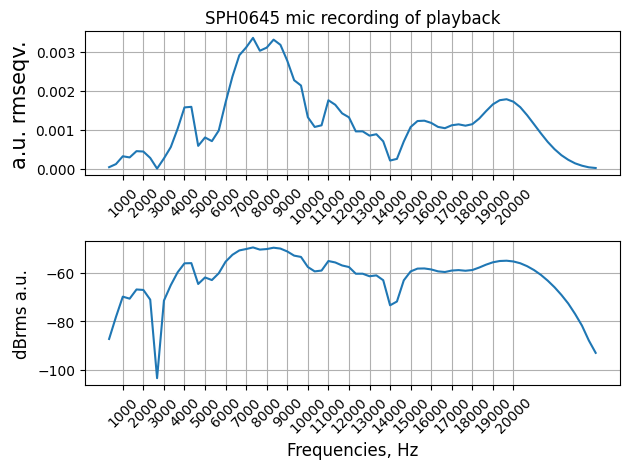

In [8]:
# Target microphone. Here we'll cover the case where we only get an RMS/Pa
# sensitivity. The other option is to calculate a mV/Pa sensitivity - which allows
# you to use the mic aross different ADCs - but also needs more info on the ADC specs

SPH0645_centrefreqs, SPH0645_freqrms = calc_native_freqwise_rms(SPH0645_pbk_audio, fs_SPH0645)

# Filter out the frequencies that are not in the original signal 
mask = (SPH0645_centrefreqs >= start_f) & (SPH0645_centrefreqs <= end_f)

idx_start = np.where(SPH0645_centrefreqs >= start_f)[0][0]
idx_end = np.where(SPH0645_centrefreqs <= end_f)[0][-1]
print("Infos about the frequencies considered in the analysis:")
print(f"Index for starting freq = {start_f} Hz: {idx_start}, correspondent frequency band: {SPH0645_centrefreqs[idx_start]} Hz")
print(f"Index for ending freq = {end_f} Hz: {idx_end}, correspondent frequency band: {SPH0645_centrefreqs[idx_end]} Hz")

SPH0645_centrefreqs = SPH0645_centrefreqs[mask]

SPH0645_freqrms = SPH0645_freqrms[idx_start:idx_end+1]

plt.figure()
a0 = plt.subplot(211)
plt.plot(SPH0645_centrefreqs, SPH0645_freqrms)
plt.ylabel('a.u. rmseqv.', fontsize=15)
plt.title('SPH0645 mic recording of playback')
plt.grid()
plt.xticks(np.linspace(1000, 20000, 20), rotation=45)
plt.subplot(212, sharex=a0)
plt.plot(SPH0645_centrefreqs, dB(SPH0645_freqrms))
plt.xlabel('Frequencies, Hz', fontsize=12);
plt.ylabel('dBrms a.u.', fontsize=12)
plt.grid()
plt.xticks(np.linspace(1000, 20000, 20), rotation=45)
plt.tight_layout()



7. Sensitivity calculation: 

- Knowing the characteristics of the reference GRAS mic, we can now calculate the RMS/Pa sensitivity of the target mic and plot it.
- Sensitivity value at standard reference of 1000 Hz is displayed.
- Curves and specifications from the manifacturer are also showed for comparison. 

    **NOTE** 
    The results are affected by the electronic components between the MEMs microphone itself and the raspberry pi, which can add distortion to the sensitivity response.  

The target mic has a sensitivity at 1000.0 Hz of: [-30.19286959] dB a.u. rms/Pa


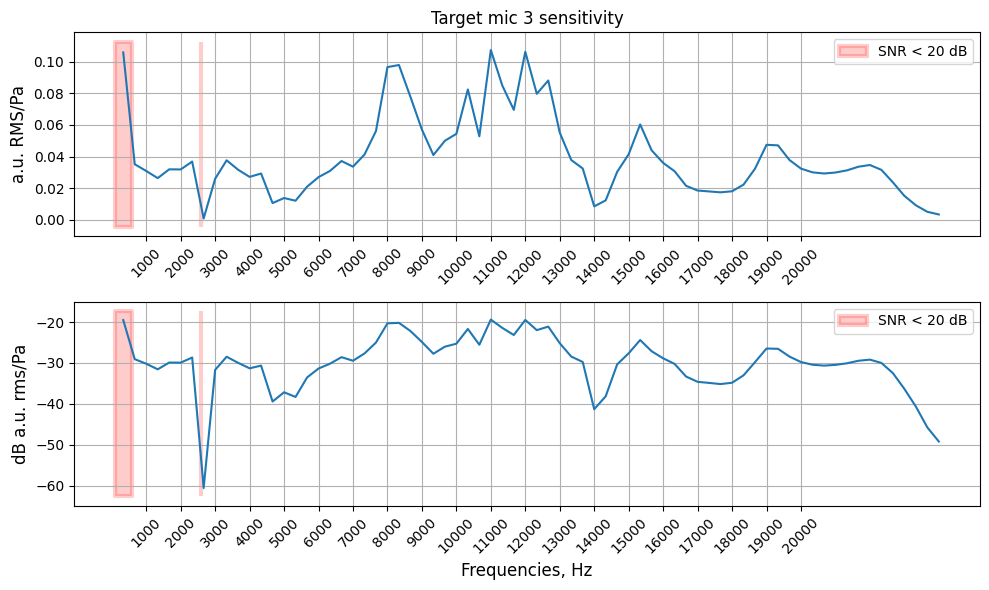

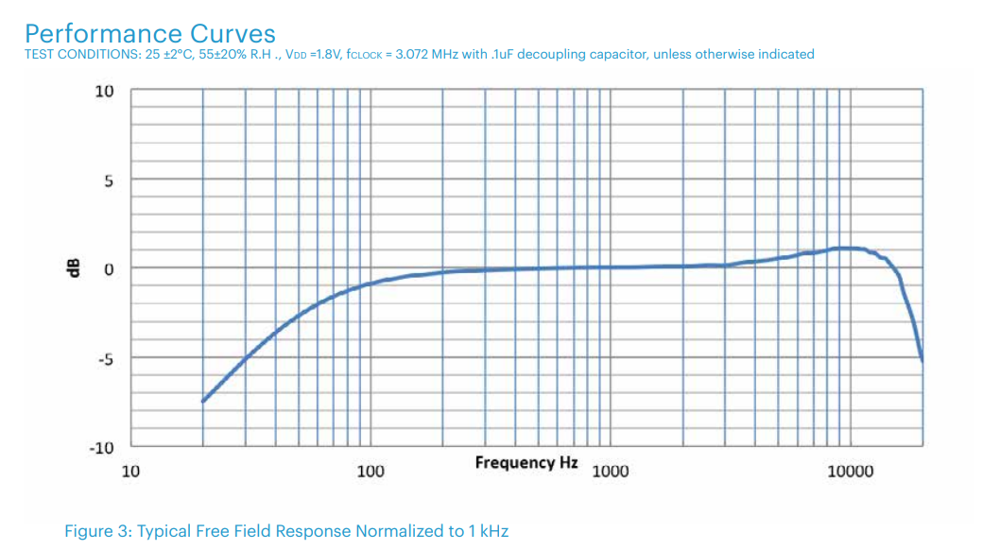

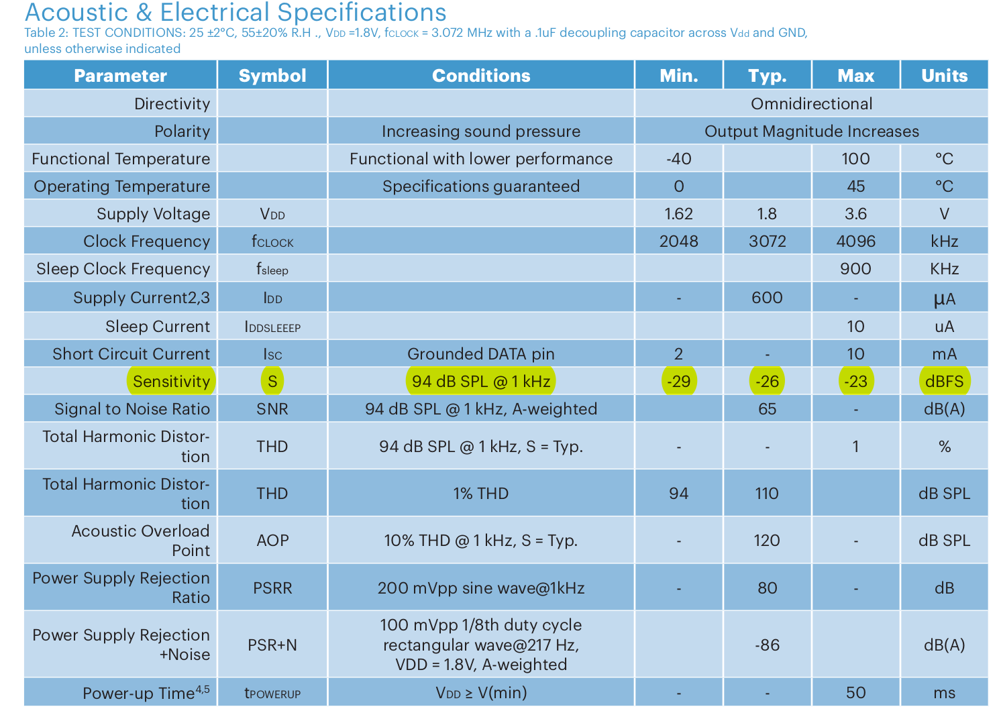

In [9]:
# Now let's calculate the RMS/Pa sensitivity using the knowledge from the 
# calibration mic
SPH0645_sensitivity = np.array(SPH0645_freqrms)/np.array(gras_freqParms)
# Print and plot the sensitivity at 1000 Hz
target_freq = 1000  # Hz
# Find the index closest to 1000 Hz
idx_1000 = np.argmin(np.abs(SPH0645_centrefreqs - target_freq))
print(f'The target mic has a sensitivity at {SPH0645_centrefreqs[idx_1000]} Hz of: {dB(SPH0645_sensitivity[idx_1000])} dB a.u. rms/Pa')

plt.figure(figsize=(10, 6))
a0 = plt.subplot(211)
plt.plot(SPH0645_centrefreqs, SPH0645_sensitivity)
snr_db = 10 * np.log10(SNR)
low_snr_mask = snr_db < 20
if np.any(low_snr_mask):
    plt.fill_between(central_freq, plt.ylim()[0], plt.ylim()[1], where=low_snr_mask, color='red', alpha=0.2, label='SNR < 20 dB', linewidth=3)
plt.ylabel('a.u. RMS/Pa', fontsize=12)
plt.title('Target mic 3 sensitivity')
plt.grid()
plt.legend()
plt.xticks(np.linspace(1000, 20000, 20), rotation=45)
plt.subplot(212, sharex=a0)
plt.plot(SPH0645_centrefreqs, dB(SPH0645_sensitivity))
if np.any(low_snr_mask):
    plt.fill_between(central_freq, plt.ylim()[0], plt.ylim()[1], where=low_snr_mask, color='red', alpha=0.2, label='SNR < 20 dB', linewidth=3)
plt.xlabel('Frequencies, Hz', fontsize=12);
plt.ylabel('dB a.u. rms/Pa', fontsize=12)
plt.grid()
plt.xticks(np.linspace(1000, 20000, 20), rotation=45)
plt.tight_layout()
plt.legend()
plt.show()

# Display the sensitivity curve and specifications of the SPH0645LM4H-B microphone
display(Image(filename="./sensitivity_curve_SPH0645LM4H-B _Knowles.png"),
        Image(filename="./Specifications_SPH0645LM4H-B_Knowles.png", width=900))

8. Results validation: Using a different audio clip we can test if the obtained results still match what we got with the reference signal:

- HighPass filtering, matched filtering, peak extraction: in this case we use the second chirp as validation signal
- The filtered sweeps are visualised to check for consistency.  


Detected peaks: gras = 8, SPH0645 = 8


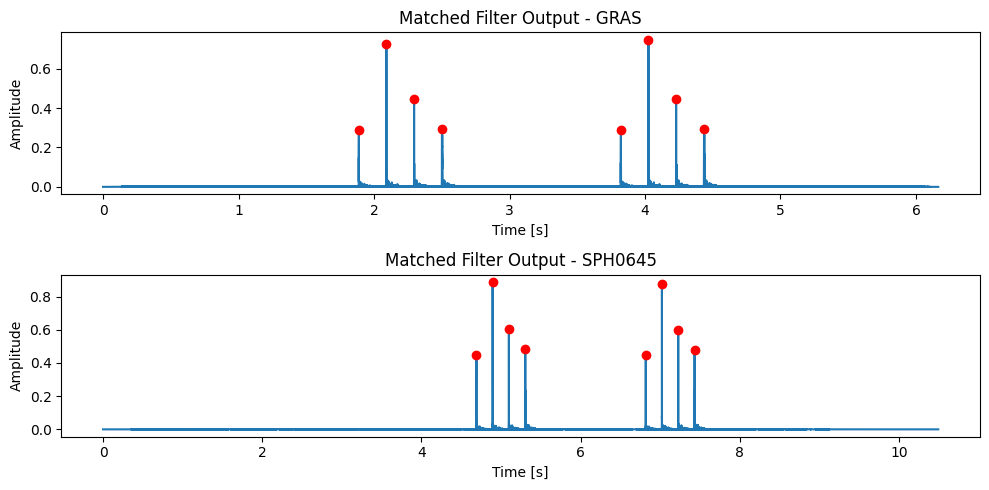

Text(0, 0.5, 'Amplitude')

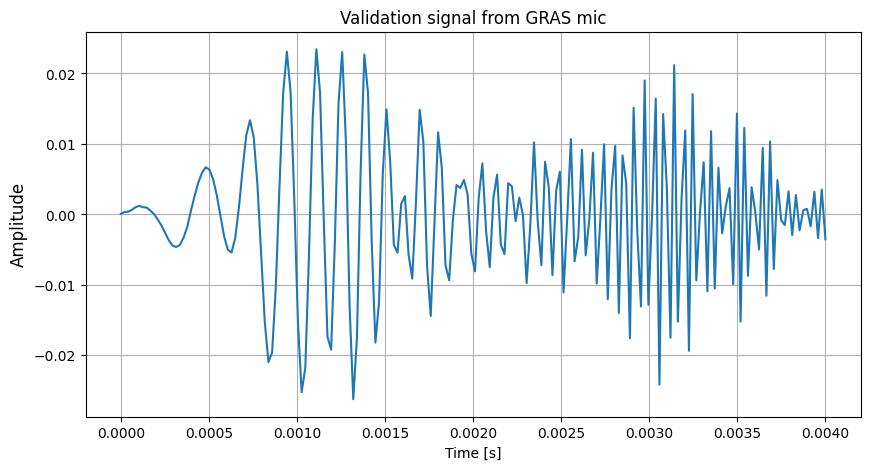

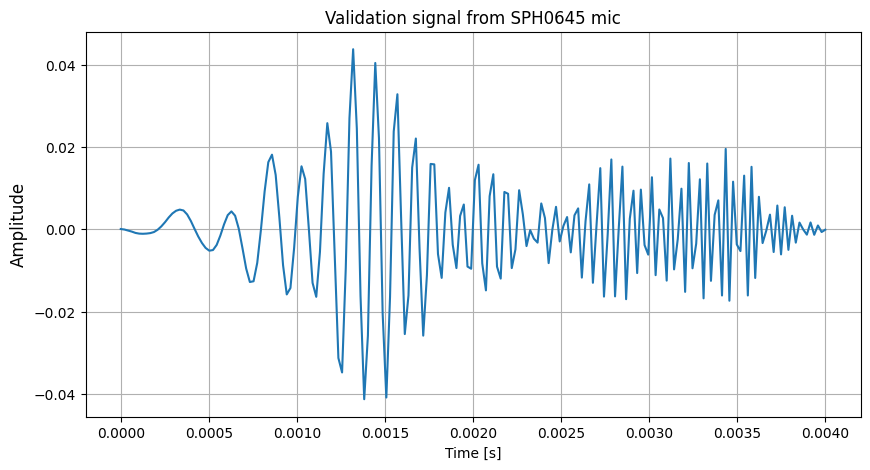

In [10]:
# We now have the target mic sensitivity - how do we use it to calculate the
# actual dB SPL? 

# Here we load a separate 'recorded sound' - a 'validation' audio clip let's call it 
chirp_to_use += 1

chirp[chirp_to_use] = sig.resample(chirp[chirp_to_use], int(fs_SPH0645*len(chirp[chirp_to_use])/fs))

gras_pbk_audio_matched = matched_filter(gras_pbk_audio_filt, chirp[chirp_to_use])
SPH0645_pbk_audio_matched = matched_filter(SPH0645_pbk_audio_filt, chirp[chirp_to_use])

# Detect peaks
peaks_gras = detect_peaks(gras_pbk_audio_matched, fs_SPH0645)
peaks_SPH0645 = detect_peaks(SPH0645_pbk_audio_matched, fs_SPH0645)
print(f"Detected peaks: gras = {len(peaks_gras)}, SPH0645 = {len(peaks_SPH0645)}")

# plot the peaks
plt.figure(figsize=(10, 5))
plt.subplot(2, 1, 1)
plt.plot(np.linspace(0, len(gras_pbk_audio_matched) / fs_SPH0645, len(gras_pbk_audio_matched)), gras_pbk_audio_matched)
plt.plot(peaks_gras/fs_SPH0645, gras_pbk_audio_matched[peaks_gras], 'ro')
plt.title('Matched Filter Output - GRAS')
plt.xlabel('Time [s]')
plt.ylabel('Amplitude')
#plt.xlim(3.5, 3.54)
plt.subplot(2, 1, 2)
plt.plot(np.linspace(0, len(SPH0645_pbk_audio_matched) / fs_SPH0645, len(SPH0645_pbk_audio_matched)), SPH0645_pbk_audio_matched)
plt.plot(peaks_SPH0645/fs_SPH0645, SPH0645_pbk_audio_matched[peaks_SPH0645], 'ro')
plt.title('Matched Filter Output - SPH0645')
plt.xlabel('Time [s]')
plt.ylabel('Amplitude')
#plt.xlim(4.325, 4.34)
plt.tight_layout()
plt.show()

gras_rec = gras_pbk_audio_filt[int(peaks_gras[chirp_to_use]):int(peaks_gras[chirp_to_use]) + int(fs_SPH0645*durns[chirp_to_use])]
recorded_sound = SPH0645_pbk_audio_filt[int(peaks_SPH0645[chirp_to_use]):int(peaks_SPH0645[chirp_to_use]) + int(fs_SPH0645*durns[chirp_to_use])]

# Plot the playback signals
plt.figure(figsize=(10,5))
plt.plot(np.linspace(0,len(gras_rec)/fs_SPH0645, len(gras_rec)) ,gras_rec)
plt.title('Validation signal from GRAS mic')
plt.grid()
plt.xlabel('Time [s]')
plt.ylabel('Amplitude', fontsize=12)
plt.figure(figsize=(10,5))
plt.plot(np.linspace(0,len(recorded_sound)/fs_SPH0645, len(recorded_sound)), recorded_sound)
plt.title('Validation signal from SPH0645 mic')
plt.grid()
plt.xlabel('Time [s]')
plt.ylabel('Amplitude', fontsize=12)

- The validation signal from the GRAS and the tested mic are compared taking into account the calculated sensitivity of both mics. The curve should match if the process is correct, since we are in both cases compensating the mic frequency response by its sensitivity. 
- SNR is polotted over the curves to show, eventually, unreliable results.


Infos about the frequencies considered in the analysis for the SPH0645LM4H-B:
Index for starting freq = 200.0 Hz: 1, correspondent frequency band: 250.0 Hz
Index for ending freq = 24000.0 Hz: 96, correspondent frequency band: 24000.0 Hz

Infos about the frequencies considered in the analysis for the GRAS mic:
Index for starting freq = 200.0 Hz: 1, correspondent frequency band: 250.0 Hz
Index for ending freq = 24000.0 Hz: 96, correspondent frequency band: 24000.0 Hz


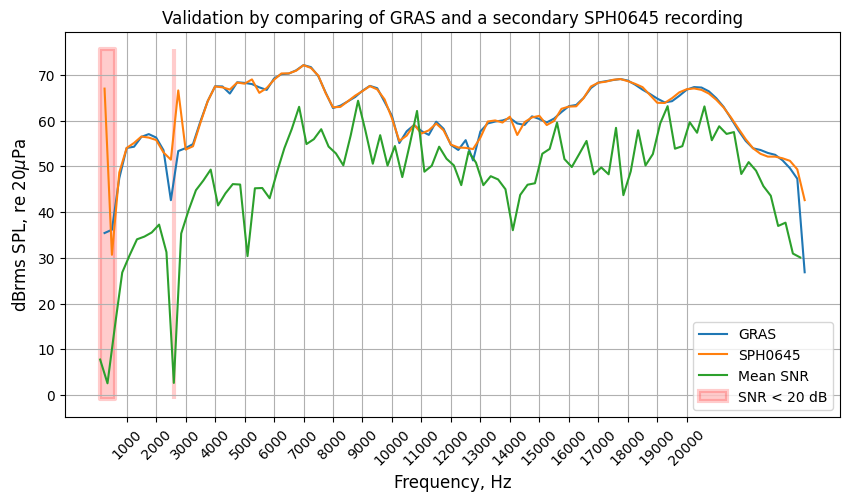

In [11]:
# And finally let's check that the calibration makes sense
# using a sound that we didn't use to calculate the sensitivity
# If the length of the recorded target mic audio here is not the same as the calibration audio. 
#  then you'll need to interpolate the microphone sensitivity using interpolate_freq_response in the
# utilities.py module
recsound_centrefreqs, freqwise_rms = calc_native_freqwise_rms(recorded_sound, fs_SPH0645)

mask = (recsound_centrefreqs >= start_f) & (recsound_centrefreqs <= end_f)
idx_start = np.where(recsound_centrefreqs >= start_f)[0][0]
idx_end = np.where(recsound_centrefreqs <= end_f)[0][-1]
print("\nInfos about the frequencies considered in the analysis for the SPH0645LM4H-B:")
print(f"Index for starting freq = {start_f} Hz: {idx_start}, correspondent frequency band: {recsound_centrefreqs[idx_start]} Hz")
print(f"Index for ending freq = {end_f} Hz: {idx_end}, correspondent frequency band: {recsound_centrefreqs[idx_end]} Hz")

recsound_centrefreqs = recsound_centrefreqs[mask]
freqwise_rms = freqwise_rms[idx_start:idx_end+1]

interp_sensitivity = interpolate_freq_response([SPH0645_centrefreqs, SPH0645_sensitivity],
                          recsound_centrefreqs)
freqwise_Parms = freqwise_rms/interp_sensitivity # go from rms to Pa(rmseq.)
freqwiese_dbspl = pascal_to_dbspl(freqwise_Parms)

gras_centrefreqs, gras_freqrms = calc_native_freqwise_rms(gras_rec, fs_SPH0645)

idx_start = np.where(gras_centrefreqs >= start_f)[0][0]
idx_end = np.where(gras_centrefreqs <= end_f)[0][-1]
print("\nInfos about the frequencies considered in the analysis for the GRAS mic:")
print(f"Index for starting freq = {start_f} Hz: {idx_start}, correspondent frequency band: {gras_centrefreqs[idx_start]} Hz")
print(f"Index for ending freq = {end_f} Hz: {idx_end}, correspondent frequency band: {gras_centrefreqs[idx_end]} Hz")

gras_centrefreqs = gras_centrefreqs[mask]
gras_freqrms = gras_freqrms[idx_start:idx_end+1]

gras_Pa = gras_freqrms/rms_1Pa_tone
gras_dbspl = pascal_to_dbspl(gras_Pa)

plt.figure(figsize=(10, 5))
plt.plot(gras_centrefreqs, gras_dbspl, label='GRAS')
plt.plot(recsound_centrefreqs, freqwiese_dbspl, label='SPH0645')
plt.plot(central_freq, 10 * np.log10(SNR), label='Mean SNR')

# Mark with red zone the frequencies with SNR lower than 20 dB
snr_db = 10 * np.log10(SNR)
low_snr_mask = snr_db < 20
if np.any(low_snr_mask):
    plt.fill_between(central_freq, plt.ylim()[0], plt.ylim()[1], where=low_snr_mask, color='red', alpha=0.2, label='SNR < 20 dB', linewidth=3)

plt.ylabel('dBrms SPL, re 20$\mu$Pa', fontsize=12)
plt.xlabel('Frequency, Hz', fontsize=12)
plt.title('Validation by comparing of GRAS and a secondary SPH0645 recording')
plt.legend()
plt.grid()
plt.xticks(np.linspace(1000, 20000, 20), rotation=45)
plt.show()

9. Sound Pressure Level (SPL) calculation in dB for the target microphone SPH0645LM4H-B
- For the GRAS mic, the frequencies contribution can be calculated  with overall rms value (method 1) or band by band (method 2). If the range of frequencies is the same the results should match.

In [12]:
# Now we know the sensitivity of the target mic - let's finally calculate
# the dB SPL of the recorded sound!
# We rely on combining the Pa rms of all relevant frequencies 
# e.g. see https://electronics.stackexchange.com/questions/642109/summing-rms-values-proof

frequency_band = [0.2e3, 24e3] # min, max frequency to do the compensation Hz
# Choose to calculate the dB SPL only for the frequency range of interest.
# Target mic
tgtmic_relevant_freqs = np.logical_and(recsound_centrefreqs>=frequency_band[0],
                                recsound_centrefreqs<=frequency_band[1])
total_rms_freqwise_Parms = np.sqrt(np.sum(freqwise_Parms[tgtmic_relevant_freqs]**2))
# Ground truth GRAS mic audio of the same sound. Here we use only the relevant 
# frequency band of the recorded sweep
gras_relevant_freqs = np.logical_and(gras_centrefreqs>=frequency_band[0],
                                gras_centrefreqs<=frequency_band[1])

#  This is one way to do it - use the RAW audio, and calculate its rms
# since we the overall flat sensitivity of the GRAS
gras_overallaudio_Parms = rms(gras_rec)/rms_1Pa_tone

# This is the other way to do it by combining RMS values
gras_totalrms_Parms = np.sqrt(np.sum(gras_Pa[gras_relevant_freqs]**2))

print(f'GRAS dBrms SPL measures: \n\nMethod 1 = {pascal_to_dbspl(gras_overallaudio_Parms)[0]}\nMethod 2 = {pascal_to_dbspl(gras_totalrms_Parms)[0]}')
print(f'\nSPH0645 dBrms SPL measure: \n{pascal_to_dbspl(total_rms_freqwise_Parms)[0]}')

GRAS dBrms SPL measures: 

Method 1 = 84.66231579510699
Method 2 = 84.59474366150617

SPH0645 dBrms SPL measure: 
84.7248071131194


# Final notes

- **point 7**: The sensitivity of the target microphone SPH0645LM4H-B from Knowles differs consistently from the manifacturer declaretion in the curve of the datasheet, however the value at 1000 Hz matches the range declared. In particular, since the declaration is calculated in dBFS, this means that the obtained value in dB rms has to be lowered by 3 dB:

    $
    S = -26 \ dBFS -3 \ dB \ rms = -29 \ dB \ rms 
    $

    $
    -23\,\mathrm{dBFS} \leq S \leq -29\,\mathrm{dBFS} \ \ => \ \ -26\,\mathrm{dB \ rms} \leq S \leq -32\,\mathrm{dB \ rms}
    $

    The value obtained by analysed mic (3) is = -30.19 dB a.u. rms/Pa, which meets the datasheet values.

Similar considerations are valid for the other mics of the array:
 
| Microphone | Sensitivity [dB a.u. rms/Pa] |
|-|-|
| 1 | -31.08709841 |
| 2 | -29.66375197 |
| 3 | -30.19286959 |
| 4 | -30.06576603 |
| 5 | -29.13025518 |

### Overall sensitivity for all the mics of the array:

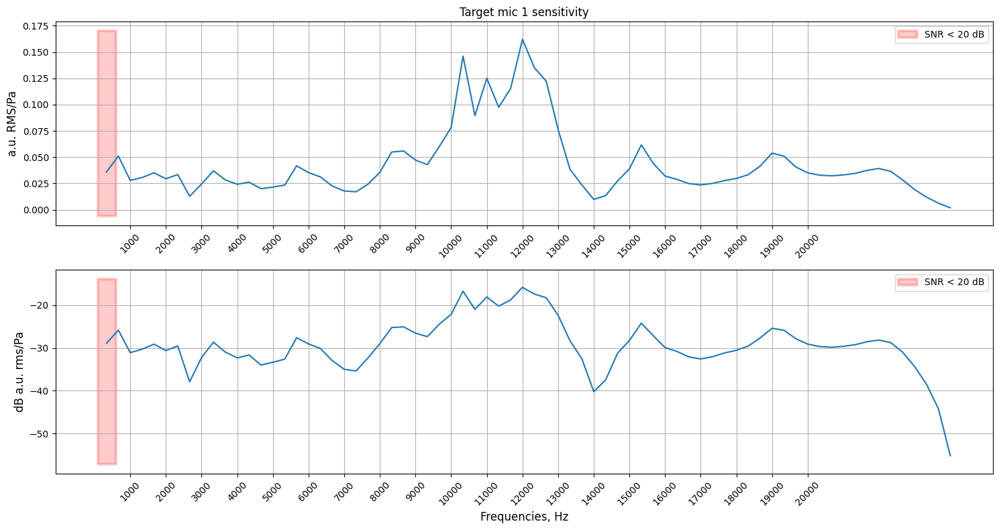

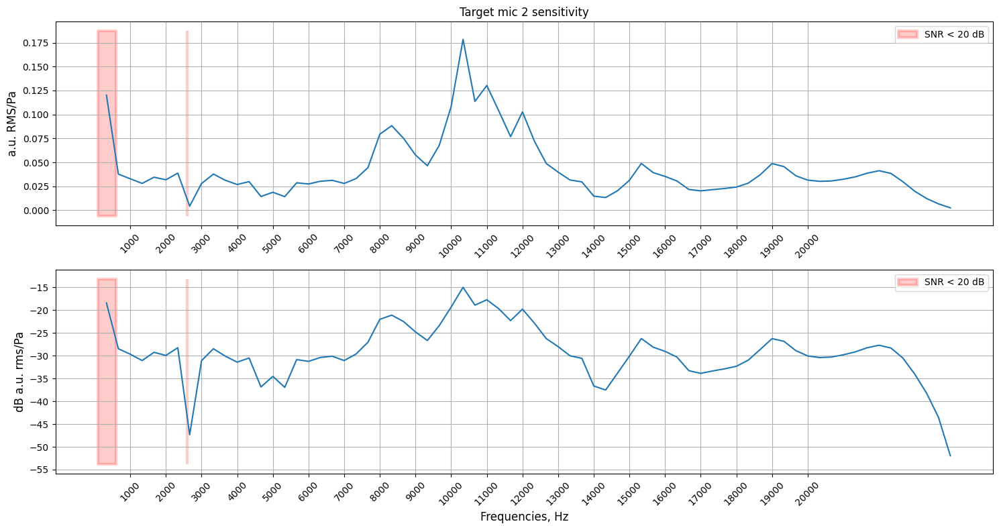

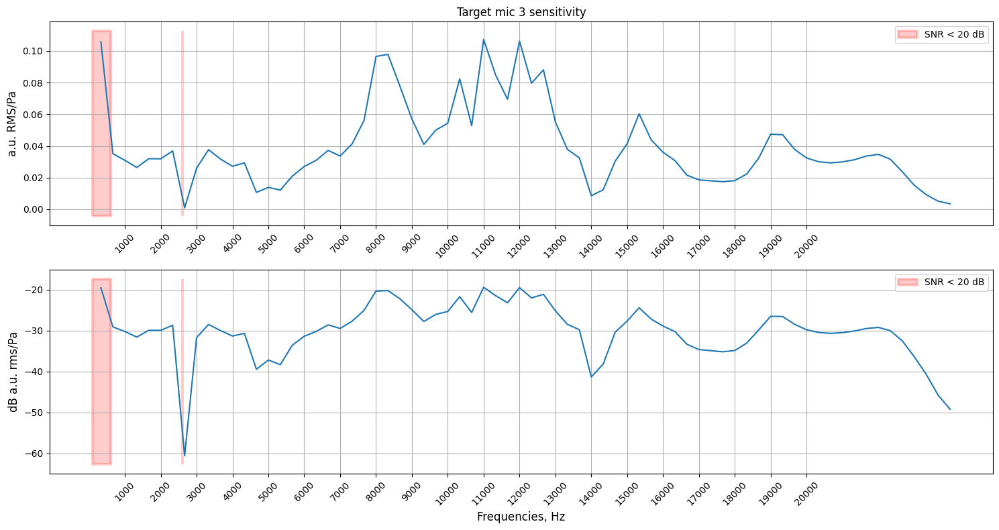

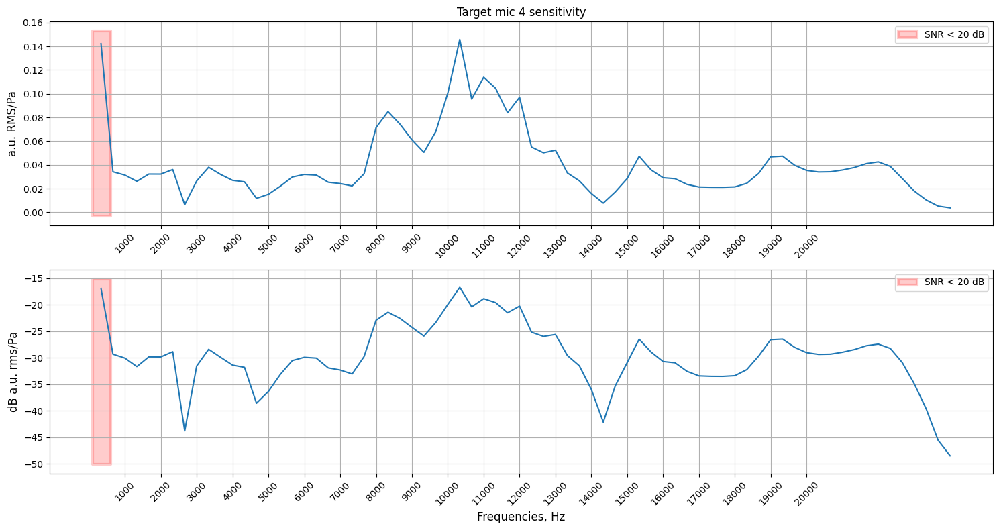

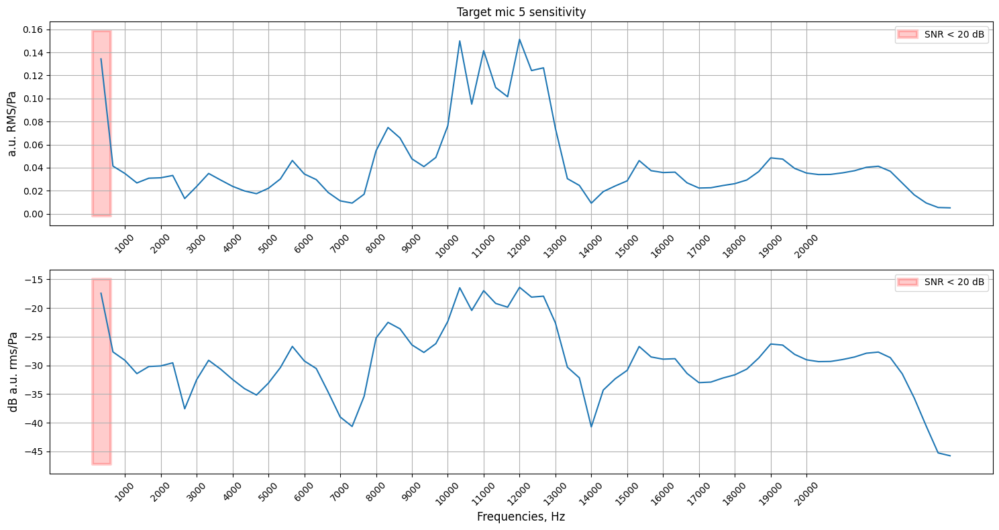

In [13]:
display(
    Image(filename="./mic1.png", width=900),
    Image(filename="./mic2.png", width=900),
    Image(filename="./mic3.png", width=900),
    Image(filename="./mic4.png", width=900),
    Image(filename="./mic5.png", width=900)
)